#Snobin Antony's At-Home Task Submission for Eedi

This task consists of two parts:

*   Part 1: Build a ComplEx knowledge graph embedding model.
*   Part 2: Implement a Negative Sampler



### Dataset Overview 📊
The given dataset represents a heterogeneous graph in which the nodes represent: _authors, books, genres, publishers, awards, and readers_. The edges represent various types of relationships between these entities, such as:

* (Author, _wrote_, Book)
* (Book, _published_by_, Publisher)
* (Book, _belongs_to_genre_, Genre)
* (Book, _won_award_, Award)
* (Reader, _read_, Book)

Dataset link: https://drive.google.com/file/d/1fzwUXMnDm_JbGYvAvgReipbVasTct8XQ/view

## Part 1: Build a ComplEx knowledge graph embedding model.

Using the provided heterogeneous book graph dataset, implement a [ComplEx](https://arxiv.org/pdf/1606.06357) knowledge graph embedding model from scratch using PyTorch. You are encouraged to optimize the model for improved performance or make any necessary enhancements.

Two helper functions, `train()` and `evaluation()`, are available for you to use when training and testing your model. The functions has been intentionally left incomplete for you to customize as you see fit.

**NOTE: Using them or training the model is NOT a requirement. But can be helpful to check model behaviour**

### Data loading and data preparation

In [1]:
import pandas as pd
import gdown

# opens a Google Drive file and loads a CSV dataset.
file_id = '1fzwUXMnDm_JbGYvAvgReipbVasTct8XQ'
# Downloading the file as a python pandas DataFrame using the Drive API.
dataset_url = f'https://drive.google.com/uc?id={file_id}'
data_df = pd.read_csv(dataset_url)
data_df.head()

,head,relation,tail
0,book_3725,won_award,award_85
1,book_1435,published_by,publisher_152
2,author_944,wrote,book_3099
3,reader_4577,read,book_2631
4,book_1633,belongs_to_genre,genre_11


For tensor management and consistent, accurate model training, handling NaNs is essential.
When turning data into tensors or training machine learning models, null or NaN values can lead to errors, especially when using libraries like PyTorch.

In [2]:
# Checking null, NaN and None values in any row
has_null_values = data_df.isnull().any(axis=1)
has_nan_values = data_df.isna().any(axis=1)

print("Has null values:", has_null_values.any())
print("Has NaN values:", has_nan_values.any())

# Remove rows with any NaN or null values
data_df = data_df.dropna()

Has null values: False
Has NaN values: False


Next, let create a NetworkX graph (G) to represent the Knowledge Graph. Each row in the DataFrame (data_df) is represented by a triple in the KG (head, relation, tail). The add_edge function creates edges between the head and tail entities by using the relation as a label. Although it is not absolutely required, building a NetworkX graph (G) can assist in determining the amount of entities (nodes) and relations (edges) in our Knowledge Graph. Without building the graph structure, also can calculate the number of unique items and relations.

In [3]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a knowledge graph
G = nx.Graph()
for _, row in data_df.iterrows():
    G.add_edge(row['head'], row['tail'], label=row['relation'])

Then, for visualization purposes only, plot the entities (nodes) and relations (edges) together in order with their labels.

In [4]:
# # Visualize the knowledge graph
# pos = nx.spring_layout(G, seed=42, k=0.9)
# labels = nx.get_edge_attributes(G, 'label')
# plt.figure(figsize=(12, 10))
# nx.draw(G, pos, with_labels=True, font_size=10, node_size=700, node_color='lightblue', edge_color='gray', alpha=0.6)
# nx.draw_networkx_edge_labels(G, pos, edge_labels=labels, font_size=8, label_pos=0.3, verticalalignment='baseline')
# plt.title('Book Knowledge Graph')
# plt.show()

In order to create the ComplEx model, we must determine how many entities and relations our knowledge graph has.


In [5]:
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()
print(f'Number of Nodes or Entities: {num_nodes}')
print(f'Number of Edges or Relations: {num_edges}')
print(f'Number of Unique Relations: {len(data_df.relation.unique())}')
print(f'Ratio edges to nodes: {round(num_edges / num_nodes, 2)}')

Number of Nodes or Entities: 11570
Number of Edges or Relations: 563295
Number of Unique Relations: 5
Ratio edges to nodes: 48.69


It is usually necessary to retrieve each row from a DataFrame in the form of (head, relation, tail) in order to extract triples for usage in a Knowledge Graph.

In [6]:
def convert_df_to_triples(data_df):
    # Extract the triples from the DataFrame
    triples = []
    for _, row in data_df.iterrows():
        head = row['head']
        relation = row['relation']
        tail = row['tail']
        triples.append((head, relation, tail))

    return triples

triples = convert_df_to_triples(data_df)
print(triples)

[('book_3725', 'won_award', 'award_85'), ('book_1435', 'published_by', 'publisher_152'), ('author_944', 'wrote', 'book_3099'), ('reader_4577', 'read', 'book_2631'), ('book_1633', 'belongs_to_genre', 'genre_11'), ('reader_2664', 'read', 'book_252'), ('reader_444', 'read', 'book_319'), ('reader_575', 'read', 'book_2289'), ('reader_3325', 'read', 'book_3673'), ('reader_2916', 'read', 'book_4990'), ('reader_2654', 'read', 'book_1284'), ('book_4334', 'won_award', 'award_140'), ('book_2510', 'belongs_to_genre', 'genre_15'), ('book_4498', 'won_award', 'award_17'), ('book_3503', 'published_by', 'publisher_97'), ('book_1085', 'published_by', 'publisher_47'), ('author_188', 'wrote', 'book_3740'), ('author_175', 'wrote', 'book_3593'), ('author_25', 'wrote', 'book_223'), ('author_838', 'wrote', 'book_4485'), ('reader_4420', 'read', 'book_4099'), ('reader_74', 'read', 'book_197'), ('book_1769', 'belongs_to_genre', 'genre_17'), ('author_668', 'wrote', 'book_2786'), ('reader_3666', 'read', 'book_3215

The triples in the form of (head, relation, tail) representing string-based data and it must be converted into numeric indices. The conversion is necessary for graph-based processing model creations because these methods usually require numerical input instead of strings.

In [7]:
# Step 1: Extract unique entities (from head and tail) and unique relations
entities = set()
relations = set()

for h, r, t in triples:
    entities.add(h)
    entities.add(t)
    relations.add(r)

# Step 2: Create mappings for entities and relations
entity2idx = {entity: idx for idx, entity in enumerate(entities)}
relation2idx = {relation: idx for idx, relation in enumerate(relations)}

print("Entity to Index Mapping:", entity2idx)
print("Relation to Index Mapping:", relation2idx)

Entity to Index Mapping: {'book_1737': 0, 'book_362': 1, 'book_1117': 2, 'reader_3179': 3, 'book_4791': 4, 'book_668': 5, 'book_1920': 6, 'reader_4229': 7, 'book_963': 8, 'reader_2990': 9, 'book_1701': 10, 'author_41': 11, 'publisher_39': 12, 'book_1640': 13, 'book_2503': 14, 'reader_300': 15, 'book_1178': 16, 'reader_4032': 17, 'book_3501': 18, 'book_270': 19, 'reader_3545': 20, 'book_4145': 21, 'book_1383': 22, 'book_4230': 23, 'reader_1419': 24, 'book_3881': 25, 'book_2999': 26, 'book_891': 27, 'reader_3935': 28, 'author_251': 29, 'book_1431': 30, 'reader_342': 31, 'reader_2274': 32, 'reader_343': 33, 'book_3246': 34, 'author_850': 35, 'reader_1033': 36, 'book_714': 37, 'book_1033': 38, 'book_3798': 39, 'reader_2913': 40, 'reader_4010': 41, 'author_583': 42, 'reader_127': 43, 'book_704': 44, 'reader_1717': 45, 'reader_2224': 46, 'reader_45': 47, 'book_2448': 48, 'reader_3779': 49, 'book_587': 50, 'book_3780': 51, 'publisher_27': 52, 'reader_116': 53, 'book_340': 54, 'book_2568': 55,

In [8]:
# # Step 3: Convert triples to indexed form
# indexed_triples = []
# for h, r, t in triples:
#     indexed_h = entity2idx[h]
#     indexed_r = relation2idx[r]
#     indexed_t = entity2idx[t]
#     indexed_triples.append((indexed_h, indexed_r, indexed_t))

# print("Indexed Triples:", indexed_triples)

In [9]:
from sklearn.model_selection import train_test_split

# Split triples into training and validation sets
train_triples, val_triples = train_test_split(triples, test_size=0.2, random_state=42)
# # Split triples into training and validation sets with indexed_triples
# train_triples, val_triples = train_test_split(indexed_triples, test_size=0.2, random_state=42)
print("Training triples size:", len(train_triples))
print("Validation triples size:", len(val_triples))

Training triples size: 480000
Validation triples size: 120000


In order to load triples of a knowledge graph (KG) into a format that PyTorch complEx models can use, the below code develops a custom PyTorch dataset class called KG_Dataset. To process the knowledge graph entities and relations numerically we map the string based triples with the help of above created indices of entity2idx, relation2idx.

In [10]:
import torch
from torch.utils.data import Dataset, DataLoader

class KGDataset(Dataset):
    def __init__(self, triples, entity2idx, relation2idx):
        """
        triples: List of (head, relation, tail) tuples
        entity2idx: Dictionary mapping entities to indices
        relation2idx: Dictionary mapping relations to indices
        """
        self.triples = triples
        self.entity2idx = entity2idx
        self.relation2idx = relation2idx

    def __len__(self):
        return len(self.triples)

    def __getitem__(self, index):
        head, relation, tail = self.triples[index]
        return self.to_tensor(head, relation, tail)

    def to_tensor(self, head, relation, tail):
        """
        Converts head, relation, tail from strings to tensors of indices.
        """
        head_idx = torch.tensor(self.entity2idx[head], dtype=torch.long)
        relation_idx = torch.tensor(self.relation2idx[relation], dtype=torch.long)
        tail_idx = torch.tensor(self.entity2idx[tail], dtype=torch.long)

        return head_idx, relation_idx, tail_idx

# Create instances of the KGDataset for training and validation
train_loader = DataLoader(KGDataset(train_triples, entity2idx, relation2idx), batch_size=128, shuffle=True)
val_loader = DataLoader(KGDataset(val_triples, entity2idx, relation2idx), batch_size=128, shuffle=False)
print("train_loader:", len(train_loader))
print("val_loader:", len(val_loader))

train_loader: 3750
val_loader: 938


### ComplEx Model

This implementation of the ComplEx model is an improved version of the ComplEx (Complex Embeddings) model, which is intended to reflect asymmetric relationships in knowledge graph triple representation. In order to better represent symmetric and asymmetric relations, this model incorporates complex-valued embeddings by employing distinct embeddings for the real and imaginary components.

In [11]:
import torch.nn as nn
from torch.optim import Adam
import os

# Create the ComplEx model
num_entities = 11570
num_relations = 5
# The embedding_dim defines the dimensionality of imaginary and real embeddings and can be adjusted for performance tuning.
embedding_dim = 128


class ComplEx(nn.Module):
  def __init__(self, num_entities, embedding_dim):
    super(ComplEx, self).__init__()
    # entities and relations separate embeddings for real and imaginary parts
    self.ent_re_embeddings = nn.Embedding(num_entities, embedding_dim)
    self.ent_im_embeddings = nn.Embedding(num_entities, embedding_dim)
    self.rel_re_embeddings = nn.Embedding(num_relations, embedding_dim)
    self.rel_im_embeddings = nn.Embedding(num_relations, embedding_dim)

  def forward(self, head, relation, tail):
    # Get real and imaginary embeddings of head, relation and tail separately
    head_real = self.ent_re_embeddings(head)
    head_imag = self.ent_im_embeddings(head)
    relation_real = self.rel_re_embeddings(relation)
    relation_imag = self.rel_im_embeddings(relation)
    tail_real = self.ent_re_embeddings(tail)
    tail_imag = self.ent_im_embeddings(tail)

    projected_head = head_real * relation_real - head_imag * relation_imag
    projected_tail = tail_real * relation_real + tail_imag * relation_imag
    return torch.sigmoid(torch.sum(projected_head * tail_real + projected_tail * tail_imag, dim=-1))

os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
CUDA_LAUNCH_BLOCKING = "1"

# Set the device (GPU if available, otherwise CPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Create an instance of the ComplEx model
model = ComplEx(num_entities, embedding_dim)
model.to(device)

# Create the loss function
loss_fn = nn.BCELoss()
# loss_fn=nn.BCEWithLogitsLoss()

# Create the optimizer
optimizer = Adam(model.parameters(), lr=0.001)

The above is the enhanced version of ComplEx model.


* It is more adaptable and able to capture intricate interactions since it uses distinct embeddings for actual and fictional elements.
* Allows for more meaningful interactions between entities and relations by applying complex multiplication in an organized manner that respects complex number arithmetic.
* use a sigmoid-based scoring function to produce probabilities that work well for relation prediction training and are consistent with binary cross-entropy loss.

For knowledge graph embedding tasks, this improved ComplEx model works well, particularly when it comes to anticipating and modeling asymmetric relations.

### Training

In [12]:
# Training loop with customized metrics and early stopping.
def train(dataloader: DataLoader, model: ComplEx, loss_fn: nn.BCELoss(), optimizer: Adam, device: str) -> None:
  """
  Args:
      dataloader: DataLoader for the training data.
      model: ComplEx model instance.
      loss_fn: Loss function (BCELoss for link prediction).
      optimizer: Adam optimizer for model training.
      device: Device for training (CPU or GPU).
  """

  model.train()  # Set model to training mode
  size = len(dataloader.dataset)
  best_loss = float('inf')
  epochs_without_improvement = 0
  steps_without_improvement = 0
  num_epochs =  5

  step_losses = []

  print("training")
  for epoch in range(num_epochs):  # Hyperparameter: number of epochs
    print(f"Epoch: {epoch+1}")
    for batch, (head, relation, tail) in enumerate(dataloader):

      X = (head.to(device), tail.to(device))
      y = relation.to(device)

      y = torch.ones(head.size(0), device=device)
      # converting y (relation) to the type float
      # y = y.type(torch.float32) #LogitsLoss

      pred = model(X[0], relation.to(device), X[1])
      #pred = model(X[0], y[0].type(torch.long), X[1])  # LogitsLoss #Assuming relation is int for indexing

      # If we have relation indices and loss needs to be over relation indices
      loss = loss_fn(pred, y)
      # If we have labels 0,1 for triples instead of relations
      # loss = loss_fn(pred, torch.tensor([1.0 if pred_i >= 0.5 else 0.0 for pred_i in pred]).to(device))

      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      # Track losses
      step_losses.append(loss.item())
      if batch % 10 == 0:
        loss, current = loss.item(), batch * len(head)
        print(f"Epoch: {epoch+1} | loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")

        # Jumping to next epoch for early stopping with a patience of 100 steps
        print(loss,best_loss)
        if loss < best_loss:
          best_loss = loss
          steps_without_improvement = 0
        else:
          steps_without_improvement += 10
          print("steps_without_improvement", steps_without_improvement)
          if steps_without_improvement >= 1000:
            print(f"Early stopping at epoch {epoch+1} and at step {batch}")
            best_loss = loss
            steps_without_improvement = 0
            return step_losses

# Calling the training function to Train the model
step_losses = train(train_loader, model, loss_fn, optimizer, device)

training
Epoch: 1
Epoch: 1 | loss: 15.919244  [    0/480000]
15.919243812561035 inf
Epoch: 1 | loss: 13.960546  [ 1280/480000]
13.960546493530273 15.919243812561035
Epoch: 1 | loss: 14.791301  [ 2560/480000]
14.791300773620605 13.960546493530273
steps_without_improvement 10
Epoch: 1 | loss: 13.110211  [ 3840/480000]
13.110211372375488 13.960546493530273
Epoch: 1 | loss: 10.561385  [ 5120/480000]
10.561385154724121 13.110211372375488
Epoch: 1 | loss: 12.240986  [ 6400/480000]
12.240985870361328 10.561385154724121
steps_without_improvement 10
Epoch: 1 | loss: 10.854833  [ 7680/480000]
10.854832649230957 10.561385154724121
steps_without_improvement 20
Epoch: 1 | loss: 8.184114  [ 8960/480000]
8.184114456176758 10.561385154724121
Epoch: 1 | loss: 11.187345  [10240/480000]
11.187344551086426 8.184114456176758
steps_without_improvement 10
Epoch: 1 | loss: 9.692259  [11520/480000]
9.692258834838867 8.184114456176758
steps_without_improvement 20
Epoch: 1 | loss: 7.886539  [12800/480000]
7.8865

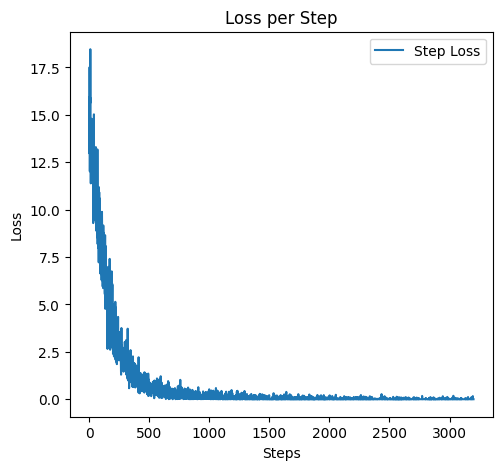

In [13]:
# Plot the loss per step and per epoch
plt.figure(figsize=(12, 5))

# Step-wise loss plot
plt.subplot(1, 2, 1)
plt.plot(step_losses, label="Step Loss")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.title("Loss per Step")
plt.legend()


It appears that encountering a problem where the model converges too rapidly during the training loop, despite having 480,000 steps. This could be due to the labels we are using. Specifically, setting y = torch.ones(head.size(0), device=device) implies that we are treating all relations as positive. When all the target labels are identical that means no negatives, the model can quickly learn to predict that single output.

Evaluation

In [14]:
#  Evaluation loop calculating hits@k and MRR (Mean Reciprocal Rank).
def evaluate(dataloader: DataLoader, model: ComplEx, device: str, k: int = 10) -> None:
  """
  Args:
      dataloader: DataLoader for the evaluation data.
      model: ComplEx model instance.
      device: Device for evaluation (CPU or GPU).
      k: Number of top entities to consider for ranking (hits@k).
  """
  model.eval()
  with torch.no_grad():
    all_ranks = []
    for batch in dataloader:
      # Move each tensor in the batch to the device individually
      head, relation, tail = batch
      head = head.to(device)
      relation = relation.to(device)
      tail = tail.to(device)

      # Calculate scores for all possible tail entities for a given head and relation
      all_tail_embeddings = model.ent_re_embeddings.weight # Assuming you want to use entity embeddings for scoring
      # Iterate over the batch of triples one by one
      for i in range(head.shape[0]):
          # Get the head, relation, and tail for the current triple
          current_head, current_relation, current_tail = head[i], relation[i], tail[i]

          # Calculate the scores for all entities as potential tails
          tail_scores = model(current_head.repeat(all_tail_embeddings.size(0)),
                              current_relation.repeat(all_tail_embeddings.size(0)),
                              torch.arange(all_tail_embeddings.size(0)).to(device))

          # Get the actual tail entity index for the current triple
          actual_tail_index = current_tail.item()

          # Calculate rank of the actual tail entity
          rank = torch.nonzero(tail_scores >= tail_scores[actual_tail_index], as_tuple=False).flatten()
          if rank.size(0) == 0:
            rank = torch.tensor([tail_scores.size(0)])
          rank = rank[0].item() + 1  # Convert to 1-based indexing
          all_ranks.append(rank)

          # Calculate hits@k and MRR
          hits = torch.mean((torch.tensor(all_ranks) <= k).float())
          mrr = torch.mean(1.0 / torch.tensor(all_ranks))
          print(f"hits@{k}: {hits:>7f}")
          print(f"MRR: {mrr:>7f}")
          return hits, mrr

# Calling the evaluation function to Evaluate the model on the validation set
evaluate(val_loader, model, device)

hits@10: 1.000000
MRR: 1.000000


(tensor(1.), tensor(1.))

## Part 2: Implement a Negative Sampler

In this section, we will address the challenge our model faces under the Open World Assumption: distinguishing between false facts and missing ones. To assist our model in learning this distinction, we will employ a Negative Sampling strategy. This involves generating "corrupted" versions of existing facts, which we will use as negative samples.

### Requirements

1. Implement a negative sampler that corrupts the tail entity (you are encouraged to create the data-informed version) __(code needed)__
2. Explain how you would integrate it into the training pipeline __(text needed)__
    * When/ Where are the negative samples going to be generated?
    * How are they going to be used and what loss functions will you use and why?
    * How could it affect your evaluation pipeline?

You can re-use/alter any code that you previously made

**NOTE: For the 2nd Requirement you do not need to implement the training code. Just provide your answer in text**

1. Implement a negative sampler that corrupts the tail entity (you are encouraged to create the data-informed version) __(code needed)__


In [15]:
import torch

# Generates negative samples by corrupting the tail entity of each triple.
def generate_negative_samples(batch, num_negatives, num_entities):
    """
    Args:
        batch: A tuple of tensors (head, relation, tail).
        num_negatives: The number of negative samples to generate for each positive triple.
        num_entities: The total number of entities in the knowledge graph.

    Returns:
        A tuple containing negative samples and their corresponding labels.
    """

    head, relation, tail = batch
    negative_samples = []
    negative_labels = []

    for h, r, t in zip(head, relation, tail):
        for _ in range(num_negatives):
            negative_tail = torch.randint(0, num_entities, (1,), device=h.device)
            negative_samples.append((h, r, negative_tail[0]))  # Extract the scalar value from the tensor
            negative_labels.append(torch.tensor(0, device=h.device))

    negative_samples = torch.tensor(negative_samples)
    negative_labels = torch.tensor(negative_labels)

    return negative_samples, negative_labels

num_negatives = 10
num_entities = 11570
for batch in train_loader:
    head, relation, tail = batch
    negative_samples, negative_labels = generate_negative_samples(batch, num_negatives, num_entities)
    # print(negative_samples, negative_labels)

2. Explain how you would integrate it into the training pipeline __(text needed)__
    * When/ Where are the negative samples going to be generated?
    * How are they going to be used and what loss functions will you use and why?
    * How could it affect your evaluation pipeline?

    * When/ Where are the negative samples going to be generated?

There are two main approaches to integrate negative sampling:

Before Training: Pre-generate negative samples for each positive triple in the training set. You can use the data_informed_tail_corrupt_sampler function from the previous section to create these negatives. This approach can be memory-intensive for large datasets.

On-the-fly Sampling: Generate negative samples during each training iteration (epoch) alongside positive samples. This can be more efficient for memory but might require additional modifications to the dataloader.

Here we are using the On-the-fly Sampling.

    * How are they going to be used and what loss functions will you use and why?

Constructing Training Batches: Modify the dataloader to yield batches containing both positive and negative samples.
This could involve, Combining pre-generated positive and negative samples into a single dataset. Extending the dataloader logic to generate negative samples on-the-fly and combine them with positive samples from the original data.

Training and Loss Function: Update the training loop to handle both positive and negative samples. During each training iteration, process both positive and negative samples within the batch. Adapt the loss function to handle the binary classification task (positive vs. negative triples). Common choices include: Binary Cross Entropy Loss (BCELoss): This is a suitable option for predicting a probability between 0 (negative) and 1 (positive). Margin-based Loss (Hinge Loss or Softmax Loss): These functions aim to maximize the difference between positive and negative triple scores, encouraging the model to prioritize valid relationships.

    * How could it affect your evaluation pipeline?

The evaluation pipeline might require minor adjustments:
If the evaluation data uses different metrics than the training loss function (e.g., Hits@k, MRR), ensure they are still relevant for assessing the model's ability to distinguish between true and false facts.
Consider filtering out negative examples from the evaluation data before calculating metrics if they were not included during evaluation.

### Training with integrated negative sampler


In [16]:
import torch

#  Generates negative samples by corrupting the tail entity of each triple.
def generate_negative_samples(head, relation, tail, num_negatives, num_entities, device):
    """
    Args:
        batch: A tuple of tensors (head, relation, tail).
        num_negatives: The number of negative samples to generate for each positive triple.
        num_entities: The total number of entities in the knowledge graph.

    Returns:
        A tuple containing negative samples and their corresponding labels.
    """

    # head, relation, tail = batch
    negative_samples = []
    negative_labels = []

    for h, r, t in zip(head, relation, tail):
        for _ in range(num_negatives):
            # Ensure negative_tail is on the correct device
            negative_tail = torch.randint(0, num_entities, (1,), device=device)
            negative_samples.append((h.to(device), r.to(device), negative_tail[0]))  # Extract the scalar value from the tensor and move h, r to device
            negative_labels.append(torch.tensor(0, device=device))

    negative_samples = torch.tensor(negative_samples, device=device)
    negative_labels = torch.tensor(negative_labels, device=device)

    return negative_samples, negative_labels

# Training loop with customized metrics and early stopping and integrated negative sampler
def train(dataloader: DataLoader, model: ComplEx, loss_fn: nn.BCELoss(), optimizer: Adam, device: str) -> None:
  """
  Args:
      dataloader: DataLoader for the training data.
      model: ComplEx model instance.
      loss_fn: Loss function (BCELoss for link prediction).
      optimizer: Adam optimizer for model training.
      device: Device for training (CPU or GPU).
  """

  model.train()  # Set model to training mode
  size = len(dataloader.dataset)
  best_loss = float('inf')
  epochs_without_improvement = 0
  steps_without_improvement = 0
  num_epochs =  10

  step_losses = []

  print("training")
  for epoch in range(5):  # Hyperparameter: number of epochs
    print(f"Epoch: {epoch+1}")
    for batch, (head, relation, tail) in enumerate(dataloader):

      # Move head, relation, and tail to the correct device
      head = head.to(device)
      relation = relation.to(device)
      tail = tail.to(device)

      X = (head, tail)
      y = relation

      y = torch.ones(head.size(0), device=device)
      # converting y (relation) to the type float
      # y = y.type(torch.float32) #LogitsLoss

      negative_samples, negative_labels = generate_negative_samples(head, relation, tail, num_negatives, num_entities, device)

      # Combine positive and negative samples
      all_samples = torch.cat([torch.stack([head, relation, tail], dim=1), negative_samples], dim=0)
      all_labels = torch.cat([y, negative_labels], dim=0)

      pred = model(all_samples[:, 0], all_samples[:, 1], all_samples[:, 2])
      loss = loss_fn(pred, all_labels)

      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      # Track losses
      step_losses.append(loss.item())
      if batch % 10 == 0:
        loss, current = loss.item(), batch * len(head)
        print(f"Epoch: {epoch+1} | loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")

        # Jumping to next epoch for early stopping with a patience of 100 steps
        print(loss,best_loss)
        if loss < best_loss:
          best_loss = loss
          steps_without_improvement = 0
        else:
          steps_without_improvement += 10
          print("steps_without_improvement", steps_without_improvement)
          if steps_without_improvement >= 1000:
            print(f"Early stopping at epoch {epoch+1} and at step {batch}")
            best_loss = loss
            steps_without_improvement = 0
            return step_losses

num_negatives = 10
num_entities = 11570
# Calling the training function to Train the model
step_losses = train(train_loader, model, loss_fn, optimizer, device)

training
Epoch: 1
Epoch: 1 | loss: 78.853188  [    0/480000]
78.85318756103516 inf
Epoch: 1 | loss: 77.619629  [ 1280/480000]
77.61962890625 78.85318756103516
Epoch: 1 | loss: 75.951324  [ 2560/480000]
75.95132446289062 77.61962890625
Epoch: 1 | loss: 73.357903  [ 3840/480000]
73.35790252685547 75.95132446289062
Epoch: 1 | loss: 71.844788  [ 5120/480000]
71.84478759765625 73.35790252685547
Epoch: 1 | loss: 66.975449  [ 6400/480000]
66.97544860839844 71.84478759765625
Epoch: 1 | loss: 70.089012  [ 7680/480000]
70.0890121459961 66.97544860839844
steps_without_improvement 10
Epoch: 1 | loss: 69.799492  [ 8960/480000]
69.79949188232422 66.97544860839844
steps_without_improvement 20
Epoch: 1 | loss: 63.925701  [10240/480000]
63.92570114135742 66.97544860839844
Epoch: 1 | loss: 58.462200  [11520/480000]
58.46220016479492 63.92570114135742
Epoch: 1 | loss: 64.081825  [12800/480000]
64.08182525634766 58.46220016479492
steps_without_improvement 10
Epoch: 1 | loss: 54.201561  [14080/480000]
54.2

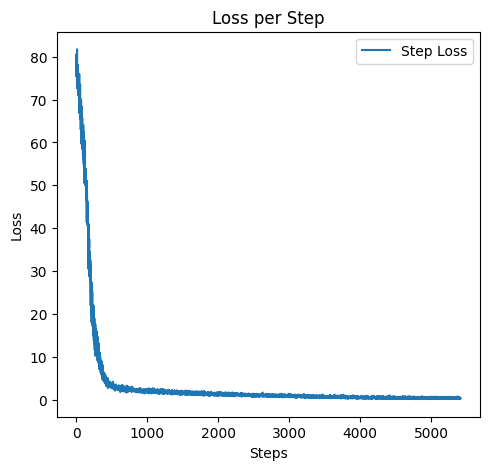

In [17]:
# Plot the loss per step and per epoch
plt.figure(figsize=(12, 5))

# Step-wise loss plot
plt.subplot(1, 2, 1)
plt.plot(step_losses, label="Step Loss")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.title("Loss per Step")
plt.legend()

## I’ve Reached the Finish Line! 🎉

  Thank you, and I’m looking forward to the feedback! 🎉